In [1]:
#!pip install librosa matplotlib pandas "tensorflow==2.8.*" "tensorflow-io==0.24.*" "tensorflow-model-optimization==0.7.2"

#!pip install git+https://github.com/ARM-software/CMSIS_5.git@5.8.0#egg=CMSISDSP\&subdirectory=CMSIS/DSP/PythonWrapper

In [2]:
import tensorflow as tf

2024-06-17 20:33:57.942390: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2024-06-17 20:33:57.942410: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [3]:
# #Descargamos el dataset ESC-50 (clasificación de sonidos)
# tf.keras.utils.get_file('esc-50.zip',
#                        'https://github.com/karoldvl/ESC-50/archive/master.zip',
#                        cache_dir='./',
#                        cache_subdir='datasets',
#                        extract=True)

In [4]:
import pandas as pd

esc50_csv = './datasets/ESC-50-master/meta/esc50.csv'
base_data_path = './datasets/ESC-50-master/audio/'

df = pd.read_csv(esc50_csv)
df.head()

,filename,fold,target,category,esc10,src_file,take
0,1-100032-A-0.wav,1,0,dog,True,100032,A
1,1-100038-A-14.wav,1,14,chirping_birds,False,100038,A
2,1-100210-A-36.wav,1,36,vacuum_cleaner,False,100210,A
3,1-100210-B-36.wav,1,36,vacuum_cleaner,False,100210,B
4,1-101296-A-19.wav,1,19,thunderstorm,False,101296,A


In [5]:
from os import path

#Añadimos una nueva columna con el path de cada archivo de audio
base_data_path = './datasets/ESC-50-master/audio/'

df['fullpath'] = df['filename'].map(lambda x: path.join(base_data_path, x))

df.head()

,filename,fold,target,category,esc10,src_file,take,fullpath
0,1-100032-A-0.wav,1,0,dog,True,100032,A,./datasets/ESC-50-master/audio/1-100032-A-0.wav
1,1-100038-A-14.wav,1,14,chirping_birds,False,100038,A,./datasets/ESC-50-master/audio/1-100038-A-14.wav
2,1-100210-A-36.wav,1,36,vacuum_cleaner,False,100210,A,./datasets/ESC-50-master/audio/1-100210-A-36.wav
3,1-100210-B-36.wav,1,36,vacuum_cleaner,False,100210,B,./datasets/ESC-50-master/audio/1-100210-B-36.wav
4,1-101296-A-19.wav,1,19,thunderstorm,False,101296,A,./datasets/ESC-50-master/audio/1-101296-A-19.wav


#### Load wave file data

We can then define a new function named `load_wav` to load audio samples from a wave file using TensorFlow's [`tf.io.read_file(...)`](https://www.tensorflow.org/api_docs/python/tf/io/read_file) and[`tf.audio.decode_wav(...)`](https://www.tensorflow.org/api_docs/python/tf/audio/decode_wav) API's. The [`tfio.audio.resample(...)`](https://www.tensorflow.org/io/api_docs/python/tfio/audio/resample) API will be used to resample the audio samples at the specified sampling rate.

[librosa](https://librosa.org/)'s [`load(...)`](https://librosa.org/doc/main/generated/librosa.load.html) API will be used as a fallback if TensorFlow is unable to decode the wave file.


In [6]:
import tensorflow_io as tfio
import librosa

def load_wav(filename, desired_sample_rate, desired_channels):
  try:
    file_contents = tf.io.read_file(filename)
    wav, sample_rate = tf.audio.decode_wav(file_contents, desired_channels=desired_channels)
    wav = tf.squeeze(wav, axis=-1)
  except:
    # fallback to librosa if the wav file can be read with TF
    filename = tf.cast(filename, tf.string)
    wav, sample_rate = librosa.load(filename.numpy().decode('utf-8'), sr=None, mono=(desired_channels == 1))
  
  wav = tfio.audio.resample(wav, rate_in=tf.cast(sample_rate, dtype=tf.int64), rate_out=tf.cast(desired_sample_rate, dtype=tf.int64))

  return wav

Now let's load the first wave file, which is a sound of a dog barking, from the pandas `DataFrame`, and plot it overtime using `matplotlib`. The [`IPython.display.Audio(...)`](https://ipython.org/ipython-doc/3/api/generated/IPython.display.html#IPython.display.Audio) API can be used to playback the audio samples inside the notebook.




2024-06-17 20:33:59.581734: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2024-06-17 20:33:59.581754: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2024-06-17 20:33:59.581768: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (Al-Ideapad): /proc/driver/nvidia/version does not exist
2024-06-17 20:33:59.581982: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-06-17 20:33:59.613948: I tensorflow_io/core/kernels/cpu_check.cc:128] Your CPU supports instructions that t

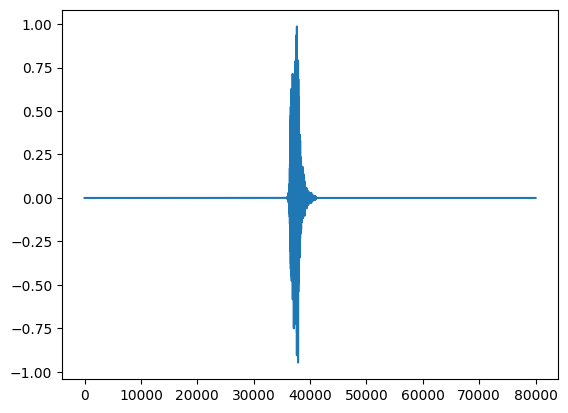

In [7]:
import matplotlib.pyplot as plt
from IPython import display

sample_rate = 16000
channels = 1

test_wav_file_path = df['fullpath'][0]
test_wav_data = load_wav(test_wav_file_path, sample_rate, channels)

plt.plot(test_wav_data)
plt.show()

display.Audio(test_wav_data, rate=sample_rate)

If we zoom in and only plot samples `32000` to `48000`, we can get a closer plot of the audio samples in the wave file in the 2 to 3 second span:

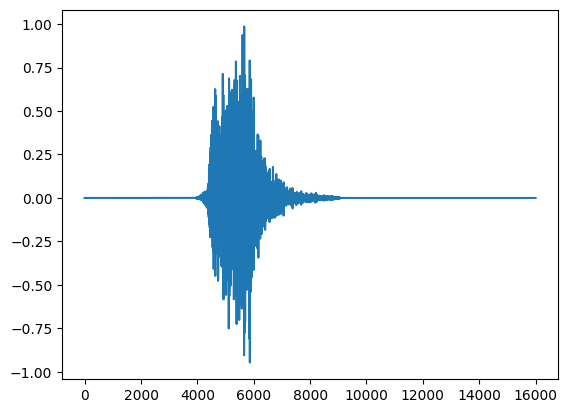

In [8]:
_ = plt.plot(test_wav_data[32000:48000])

We can then use the [`tf.data.Dataset`](https://www.tensorflow.org/api_docs/python/tf/data/Dataset) TensorFlow API to create a pipeline that loads all wave file data from the dataset.

In [9]:
fullpaths = df['fullpath']
targets = df['target']
folds = df['fold']

fullpaths_ds = tf.data.Dataset.from_tensor_slices((fullpaths, targets, folds))
fullpaths_ds.element_spec

(TensorSpec(shape=(), dtype=tf.string, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None))

Map each `fullpath` value to wave file samples:

In [10]:
def load_wav_for_map(fullpath, label, fold):
  wav = tf.py_function(load_wav, [fullpath, sample_rate, channels], tf.float32)

  return wav, label, fold

wav_ds = fullpaths_ds.map(load_wav_for_map)
wav_ds.element_spec

(TensorSpec(shape=<unknown>, dtype=tf.float32, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None))

#### Split Wave file data

We would like to train the model on 1 secound soundbites, so we must split up the 5 seconds of audio per item in the ESC-50 dataset to slices of 16000 samples. We will also stride the original audio samples `4000` samples at a time, and filter out any sound chunks that contain pure silence.

In [11]:
@tf.function
def split_wav(wav, width, stride):
  return tf.map_fn(fn=lambda t: wav[t * stride:t * stride + width], elems=tf.range((tf.shape(wav)[0] - width) // stride), fn_output_signature=tf.float32)

@tf.function
def wav_not_empty(wav):
  return tf.experimental.numpy.any(wav)

def split_wav_for_flat_map(wav, label, fold):
  wavs = split_wav(wav, width=16000, stride=4000)
  labels = tf.repeat(label, tf.shape(wavs)[0])
  folds = tf.repeat(fold, tf.shape(wavs)[0])

  return tf.data.Dataset.from_tensor_slices((wavs, labels, folds))

split_wav_ds = wav_ds.flat_map(split_wav_for_flat_map)
split_wav_ds = split_wav_ds.filter(lambda x, y, z: wav_not_empty(x))

Let's plot the first 5 soundbites over time using `matplotlib`:

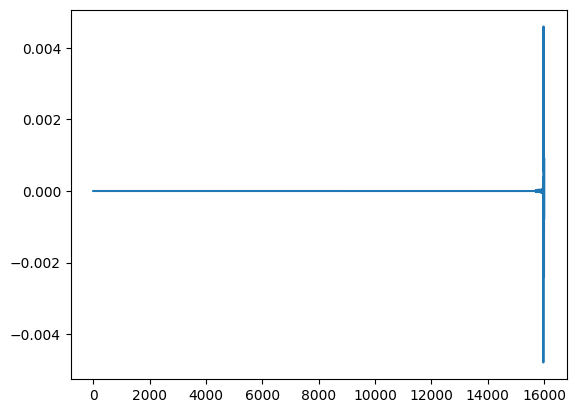

In [12]:
for wav, _, _ in split_wav_ds.take(1):
  _ = plt.plot(wav)
  plt.show()

#### Create Spectrograms

Rather than passing in the time series data directly into our TensorFlow model, we will transform the audio data into an audio spectrogram representation. This will create a 2D representation of the audio signal’s frequency content over time.

The input audio signal we will use will have a sampling rate of 16kHz, this means one second of audio will contain 16,000 samples. Using TensorFlow’s [`tf.signal.stft(...)`](https://www.tensorflow.org/api_docs/python/tf/signal/stft) function we can transform a 1 second audio signal into a 2D tensor representation. We will choose a frame length of 256 and a frame step of 128, so the output of this feature extraction stage will be a Tensor that has a shape of `(124, 129)`.


In [13]:
@tf.function
def create_spectrogram(samples):
  return tf.abs(
      tf.signal.stft(samples, frame_length=256, frame_step=128)
  )

Let's take the same 2 - 3 second interval of the first dog barking wave file and create it's spectrogram representation:

In [14]:
spectrogram = create_spectrogram(test_wav_data[32000:48000])

spectrogram.shape

TensorShape([124, 129])

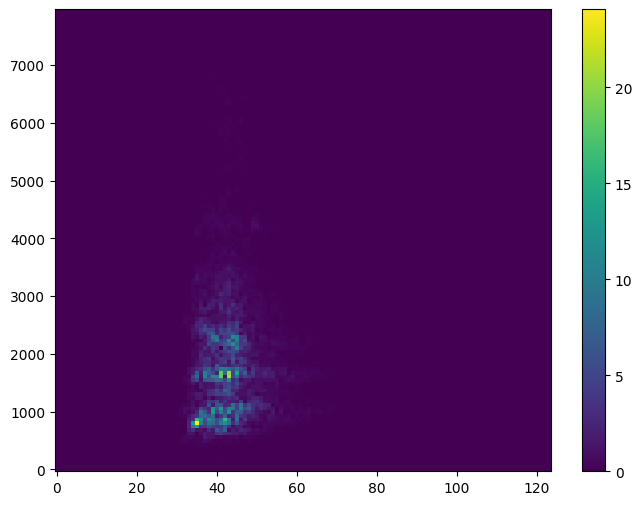

In [15]:
import numpy as np

def plot_spectrogram(spectrogram, vmax=None):
  transposed_spectrogram = tf.transpose(spectrogram)

  fig = plt.figure(figsize=(8,6))
  height = transposed_spectrogram.shape[0]
  X = np.arange(transposed_spectrogram.shape[1])
  Y = np.arange(height * int(sample_rate / 256), step=int(sample_rate / 256))

  im = plt.pcolormesh(X, Y, tf.transpose(spectrogram), vmax=vmax)

  fig.colorbar(im)
  plt.show()


plot_spectrogram(spectrogram)

Then we can map each split wave item to a spectrogram:

In [16]:
def create_spectrogram_for_map(samples, label, fold):
  return create_spectrogram(samples), label, fold

spectrograms_ds = split_wav_ds.map(create_spectrogram_for_map)
spectrograms_ds.element_spec

(TensorSpec(shape=<unknown>, dtype=tf.float32, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None))

Let's plot the first 5 spectrograms in the dataset:

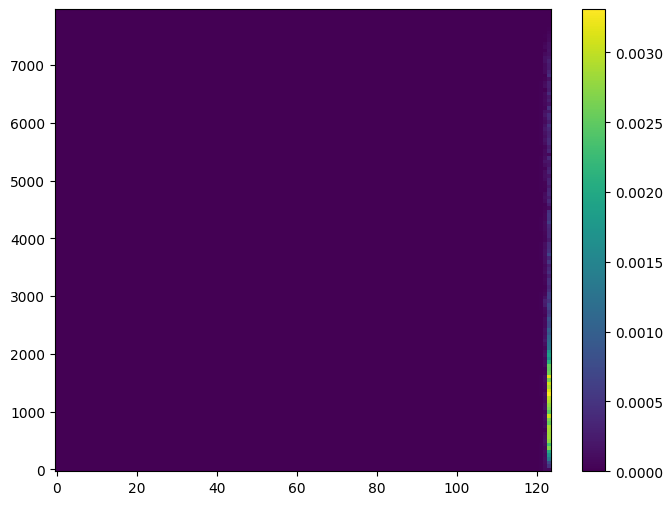

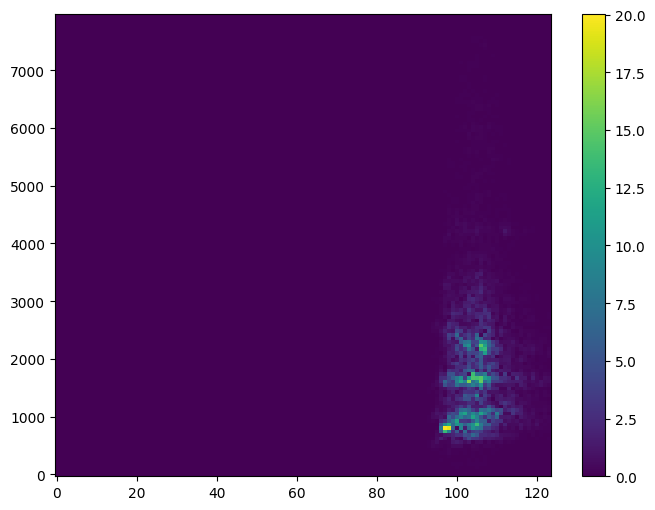

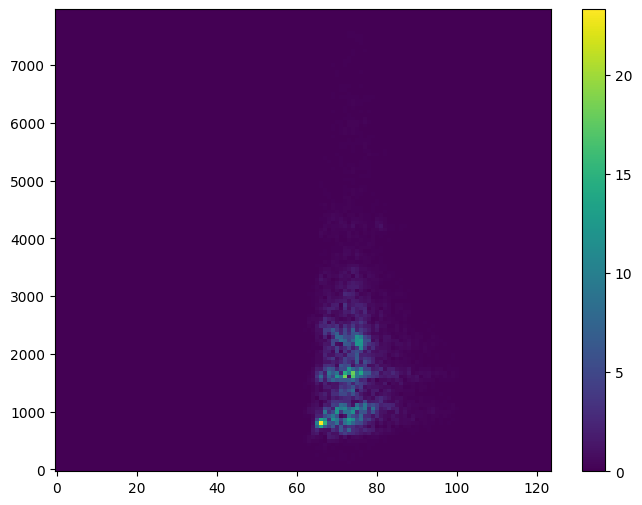

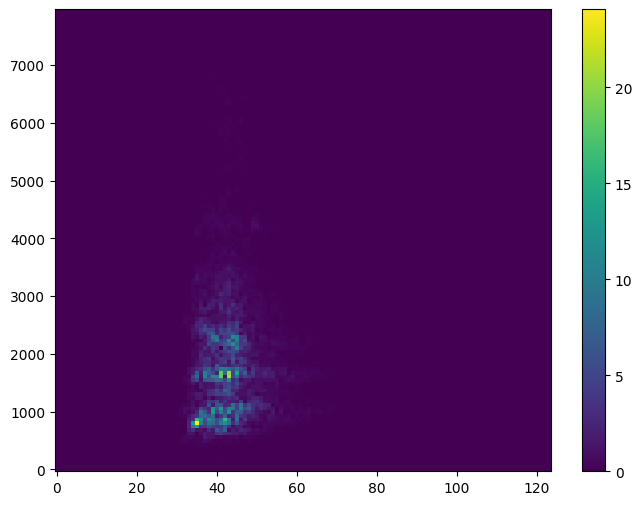

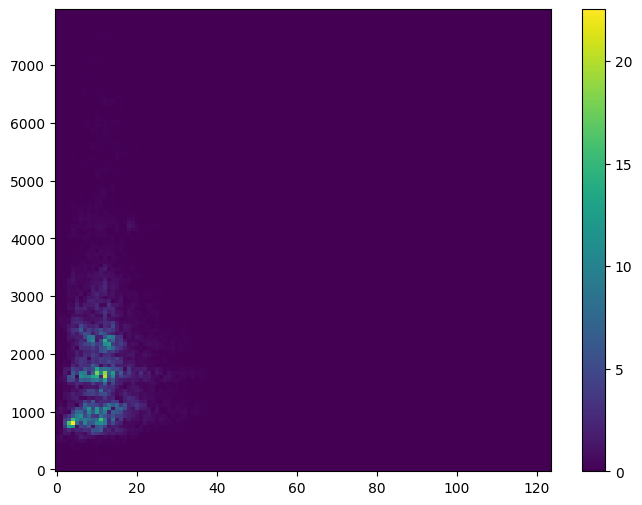

In [17]:
for s, _, _ in spectrograms_ds.take(5):
  plot_spectrogram(s)

### Split Dataset

Before we start training the ML classifier model, we must split the dataset up in three parts: training, validation, and test.

We will use the same technique in TensorFlow's [Transfer learning with YAMNet for environmental sound classification](https://www.tensorflow.org/tutorials/audio/transfer_learning_audio#split_the_data) guide, and use the `fold` column of the ESC-50 dataset to determine the split.

Before splitting the dataset, let's set a random seed for reproducibility:

In [18]:
import numpy as np
import tensorflow as tf

# Set seed for experiment reproducibility
random_seed = 42
tf.random.set_seed(random_seed)
np.random.seed(random_seed)

Entries with a `fold` value of less than 4 will used for training, the ones with a `value` will be used for validation, and finally the remaining items with be used for testing.

The `fold` column will be removed as it is no longer needed, and the dimensions of the spectrogram shape will be expanded from `(124, 129)` to `(124, 129, 1)`. The training items will also be shuffled.

In [19]:
cached_ds = spectrograms_ds.cache()

train_ds = cached_ds.filter(lambda spectrogram, label, fold: fold < 4)
val_ds = cached_ds.filter(lambda spectrogram, label, fold: fold == 4)
test_ds = cached_ds.filter(lambda spectrogram, label, fold: fold > 4)

# remove the folds column as it's no longer needed
remove_fold_column = lambda spectrogram, label, fold: (tf.expand_dims(spectrogram, axis=-1), label)

train_ds = train_ds.map(remove_fold_column)
val_ds = val_ds.map(remove_fold_column)
test_ds = test_ds.map(remove_fold_column)

train_ds = train_ds.cache().shuffle(1000, seed=random_seed).batch(32).prefetch(tf.data.AUTOTUNE)
val_ds = val_ds.cache().batch(32).prefetch(tf.data.AUTOTUNE)
test_ds = test_ds.cache().batch(32).prefetch(tf.data.AUTOTUNE)

### Train Model

Now that we have the features extracted from the audio signal, we can create a model using TensorFlow’s Keras  API. The model will consist of 8 layers:

 1. An input layer.
 1. A preprocessing layer, that will resize the input tensor from 124x129x1 to 32x32x1.
 1. A normalization layer, that will scale the input values between -1 and 1
 1. A 2D convolution layer with: 8 filters, a kernel size of 8x8, and stride of 2x2, and ReLU activation function.
 1. A 2D max pooling layer with size of 2x2
 1. A flatten layer to flatten the 2D data to 1D
 1. A dropout layer, that will help reduce overfitting during training
 1. A dense layer with 50 outputs and a softmax activation function, which outputs the likelihood of the sound category (between 0 and 1).


Before we build the model using [Tensflow's Keras API's](https://www.tensorflow.org/api_docs/python/tf/keras), we will create normalization layer and feed in all the spectrogram dataset items.

In [20]:
for spectrogram, _, _ in cached_ds.take(1):
    input_shape = tf.expand_dims(spectrogram, axis=-1).shape
    print('Input shape:', input_shape)
  
norm_layer = tf.keras.layers.experimental.preprocessing.Normalization()
norm_layer.adapt(cached_ds.map(lambda x, y, z: tf.reshape(x, input_shape)))

Input shape: (124, 129, 1)


2024-06-17 20:34:01.595155: W tensorflow/core/kernels/data/cache_dataset_ops.cc:768] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


Define a sequential 8 layer model as described above:

In [21]:
baseline_model = tf.keras.models.Sequential([
  tf.keras.layers.Input(shape=input_shape),
  tf.keras.layers.experimental.preprocessing.Resizing(32, 32, interpolation="nearest"), 
  norm_layer,
  tf.keras.layers.Conv2D(8, kernel_size=(8,8), strides=(2, 2), activation="relu"),
  tf.keras.layers.MaxPool2D(pool_size=(2,2)),
  tf.keras.layers.Flatten(),
  tf.keras.layers.Dropout(0.25),
  tf.keras.layers.Dense(50, activation='softmax')
])

baseline_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resizing (Resizing)         (None, 32, 32, 1)         0         
                                                                 
 normalization (Normalizatio  (None, 32, 32, 1)        3         
 n)                                                              
                                                                 
 conv2d (Conv2D)             (None, 13, 13, 8)         520       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 6, 6, 8)          0         
 )                                                               
                                                                 
 flatten (Flatten)           (None, 288)               0         
                                                                 
 dropout (Dropout)           (None, 288)               0

Compile the model with `accuracy` metrics, an Adam optimizer and a sparse categorical crossentropy loss function. As well as define early stopping and dynamic learning rate scheduler callbacks for training.

In [22]:
METRICS = [
      "accuracy",
]

baseline_model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=METRICS,
)

def scheduler(epoch, lr):
  if epoch < 100:
    return lr
  else:
    return lr * tf.math.exp(-0.1)

callbacks = [
    tf.keras.callbacks.EarlyStopping(verbose=1, patience=25), 
    tf.keras.callbacks.LearningRateScheduler(scheduler)
]

Train the model:

In [23]:
EPOCHS = 250
history = baseline_model.fit(
    train_ds, 
    validation_data=val_ds,  
    epochs=EPOCHS,
    callbacks=callbacks,
)

Epoch 1/250
557/557 [==============================] - 6s 10ms/step - loss: 3.4007 - accuracy: 0.1321 - val_loss: 3.4893 - val_accuracy: 0.0986 - lr: 0.0010
Epoch 2/250
557/557 [==============================] - 5s 8ms/step - loss: 2.9045 - accuracy: 0.2233 - val_loss: 3.4030 - val_accuracy: 0.1438 - lr: 0.0010
Epoch 3/250
557/557 [==============================] - 5s 8ms/step - loss: 2.7106 - accuracy: 0.2719 - val_loss: 3.3653 - val_accuracy: 0.1564 - lr: 0.0010
Epoch 4/250
557/557 [==============================] - 5s 8ms/step - loss: 2.5920 - accuracy: 0.3007 - val_loss: 3.3476 - val_accuracy: 0.1819 - lr: 0.0010
Epoch 5/250
557/557 [==============================] - 5s 8ms/step - loss: 2.4937 - accuracy: 0.3286 - val_loss: 3.2625 - val_accuracy: 0.2011 - lr: 0.0010
Epoch 6/250
557/557 [==============================] - 5s 8ms/step - loss: 2.4209 - accuracy: 0.3466 - val_loss: 3.2306 - val_accuracy: 0.2160 - lr: 0.0010
Epoch 7/250
557/557 [==============================] - 5s 8ms/s

Evaluate the loss and accuracy of the test dataset:

In [24]:
baseline_model.evaluate(test_ds)

187/187 [==============================] - 1s 2ms/step - loss: 3.9438 - accuracy: 0.2583


[3.9437546730041504, 0.2583347260951996]

The baseline model has a relatively low accuracy ~24%, however in the next steps we will use it as a starting point to fine tune a more accurate model for our use case.

Save the model:

In [25]:
baseline_model.save("baseline_model")

2024-06-17 20:39:00.017183: W tensorflow/python/util/util.cc:368] Sets are not currently considered sequences, but this may change in the future, so consider avoiding using them.


INFO:tensorflow:Assets written to: baseline_model/assets


Create a zip file of the saved model, for download purposes:

In [26]:
!zip -r baseline_model.zip baseline_model

updating: baseline_model/ (stored 0%)
updating: baseline_model/assets/ (stored 0%)
updating: baseline_model/variables/ (stored 0%)
updating: baseline_model/variables/variables.index (deflated 60%)
updating: baseline_model/variables/variables.data-00000-of-00001 (deflated 9%)
updating: baseline_model/saved_model.pb (deflated 86%)
updating: baseline_model/keras_metadata.pb (deflated 87%)


## Transfer Learning

Now we will use Transfer Learning and change the classification head of the model to train a binary classification model for fire alarm sounds.

Transfer Learning is the process of retraining a model that has been developed for a task to complete a new similar task. The idea is that the model has learned transferable "skills" and the weights and biases can be used in other models as a starting point.

Transfer learning is very common in computer vision. Big data companies spend weeks training models on ImageNet, this is not possible for most people and so people reuse the models built in these research companies to complete their own tasks. A model designed to recognise 1000 different objects in a image can be adapted to recognise other or similar objects.

As humans we use transfer learning too. The skills you developed to learn to walk could also be used to learn to run later on.

In a neural network, the first few layers of a model start to perform a "feature extraction" such as finding shapes, edges and colours. The layers later on are used as classifiers; they take the extracted features and classify them.

You can find more information and visualizations about this here https://yosinski.com/deepvis.

Because of this, we can assume the first few layers have learned quite general feature extraction techniques that can be applied to all similar tasks and so we can freeze all these layers. The classifier layer will need to be trained based on the new classes.

To do this, we break the process into two steps:
Freeze the "backbone" of the model and train the head with a fairly high learning rate. We slowly reduce the learning rate.
Unfreeze the "backbone" and fine-tune the model with a low learning rate.

In [27]:
tf.keras.utils.get_file('fire_alarms.tar.gz',
                        'https://github.com/ArmDeveloperEcosystem/ml-audio-classifier-example-for-pico/archive/refs/heads/fire_alarms.tar.gz',
                        cache_dir='./',
                        cache_subdir='datasets',
                        extract=True)

'./datasets/fire_alarms.tar.gz'

In [28]:
# Since we only need the files in the _background_noise_ folder of the dataset
# use the curl command to download the archive file and then manually extract
# using the tar command, instead of using tf.keras.utils.get_file(...) 
# in Python

#!mkdir -p datasets/speech_commands
#!curl -L -o datasets/speech_commands_v0.02.tar.gz http://download.tensorflow.org/data/speech_commands_v0.02.tar.gz
#!tar --wildcards --directory datasets/speech_commands -xzvf datasets/speech_commands_v0.02.tar.gz './_background_noise_/*'

### Load dataset

Instead of using a pandas DataFrame to load the dataset, we will load the fire alarm files and background noise files separately. The `label` and `fold` values will be mapped manually.

In [29]:
meows_files_ds = tf.data.Dataset.list_files("datasets/meows/*.wav", shuffle=False)
meows_files_ds = meows_files_ds.map(lambda x: (x, 1, -1))
print(meows_files_ds)

<MapDataset element_spec=(TensorSpec(shape=(), dtype=tf.string, name=None), TensorSpec(shape=(), dtype=tf.int32, name=None), TensorSpec(shape=(), dtype=tf.int32, name=None))>


In [30]:
background_noise_files_ds = tf.data.Dataset.list_files("datasets/bg/*.wav", shuffle=False)
background_noise_files_ds = background_noise_files_ds.map(lambda x: (x, 0, -1))

In [31]:
meows_wav_ds = meows_files_ds.map(load_wav_for_map)
meows_wav_ds = meows_wav_ds.cache()


background_noise_wav_ds = background_noise_files_ds.map(load_wav_for_map)
background_noise_wav_ds = background_noise_wav_ds.cache()

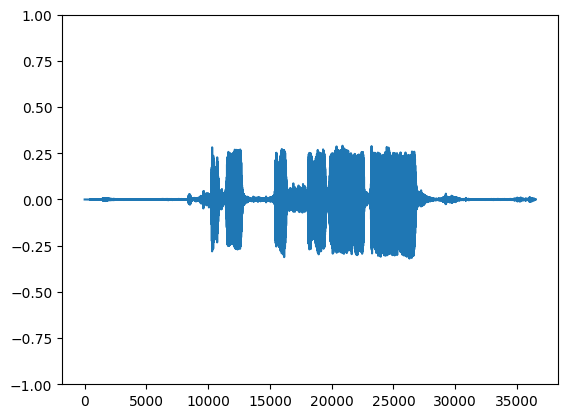

2024-06-17 20:39:01.911037: W tensorflow/core/kernels/data/cache_dataset_ops.cc:768] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


In [32]:
for wav_data, _, _ in meows_wav_ds.take(1):
  plt.plot(wav_data)
  plt.ylim([-1, 1])
  plt.show()

  display.display(display.Audio(wav_data, rate=sample_rate))

Then do the same for the first background noise file:

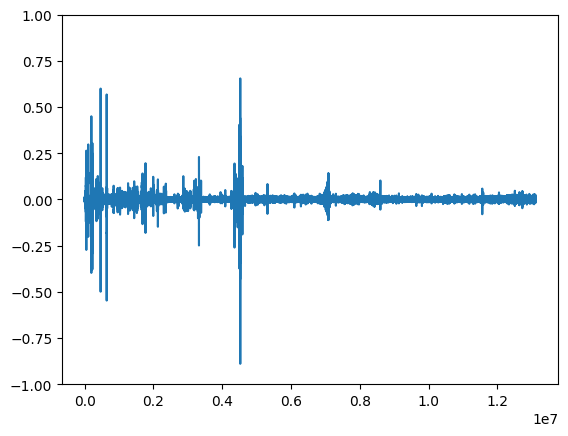

2024-06-17 20:39:05.893000: W tensorflow/core/kernels/data/cache_dataset_ops.cc:768] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


In [33]:
for wav_data, _, _ in background_noise_wav_ds.take(1):
  plt.plot(wav_data)
  plt.ylim([-1, 1])
  plt.show()

  display.display(display.Audio(wav_data, rate=sample_rate))

Then split the audio samples into 1 second soundbites:

In [34]:
import tensorflow as tf

# Function to split a waveform into overlapping segments
@tf.function
def split_wav(wav, width, stride):
    segments = tf.map_fn(
        fn=lambda t: wav[t * stride:t * stride + width],
        elems=tf.range((tf.shape(wav)[0] - width) // stride),
        fn_output_signature=tf.TensorSpec(shape=(width,), dtype=tf.float32)
    )
    return segments

# Function to check if a waveform segment is not empty
@tf.function
def wav_not_empty(wav):
    return tf.reduce_any(tf.not_equal(wav, 0.0))

# Function to check if a waveform segment's maximum value is greater than 0.03
def wav_not_noise(wav):
    return tf.reduce_any(tf.greater(wav, 0.06))


# Function to split a waveform and return a dataset of segments
def split_wav_for_flat_map(wav, label, fold):
    wavs = split_wav(wav, width=16000, stride=4000)
    labels = tf.repeat(label, tf.shape(wavs)[0])
    folds = tf.repeat(fold, tf.shape(wavs)[0])
    

    return tf.data.Dataset.from_tensor_slices((wavs, labels, folds))

# Applying the split_wav_for_flat_map and filtering the non-empty segments
split_meows_wav_ds = meows_wav_ds.flat_map(split_wav_for_flat_map)
split_meows_wav_ds = split_meows_wav_ds.filter(lambda x, y, z: wav_not_empty(x))
split_meows_wav_ds = split_meows_wav_ds.filter(lambda x, y, z: wav_not_noise(x))


split_background_noise_wav_ds = background_noise_wav_ds.flat_map(split_wav_for_flat_map)
split_background_noise_wav_ds = split_background_noise_wav_ds.filter(lambda x, y, z: wav_not_empty(x))

# Function to print first n elements of a dataset for debugging
def print_first_n_elements(ds, n):
    try:
        for i, element in enumerate(ds.take(n)):
            print(f"Element {i}: {element}")
    except Exception as e:
        print(f"Error while reading dataset: {e}")

# Debugging: Print first few elements of the resulting dataset
print("First 5 elements of split_meows_wav_ds:")
print_first_n_elements(split_meows_wav_ds, 5)


First 5 elements of split_meows_wav_ds:
Element 0: (<tf.Tensor: shape=(16000,), dtype=float32, numpy=
array([ 0.        ,  0.        ,  0.        , ..., -0.01846393,
       -0.19977924, -0.27854517], dtype=float32)>, <tf.Tensor: shape=(), dtype=int32, numpy=1>, <tf.Tensor: shape=(), dtype=int32, numpy=-1>)
Element 1: (<tf.Tensor: shape=(16000,), dtype=float32, numpy=
array([-0.00044014, -0.00098582, -0.00069075, ...,  0.19275826,
        0.07632913, -0.09962556], dtype=float32)>, <tf.Tensor: shape=(), dtype=int32, numpy=1>, <tf.Tensor: shape=(), dtype=int32, numpy=-1>)
Element 2: (<tf.Tensor: shape=(16000,), dtype=float32, numpy=
array([-8.8588806e-04, -8.2623021e-04, -1.8126647e-04, ...,
        1.2530121e-01,  2.1065162e-01,  1.5046652e-01], dtype=float32)>, <tf.Tensor: shape=(), dtype=int32, numpy=1>, <tf.Tensor: shape=(), dtype=int32, numpy=-1>)
Element 3: (<tf.Tensor: shape=(16000,), dtype=float32, numpy=
array([ 0.15545969,  0.05234629, -0.10463126, ..., -0.00158008,
        0.00

2024-06-17 20:39:07.136120: W tensorflow/core/kernels/data/cache_dataset_ops.cc:768] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


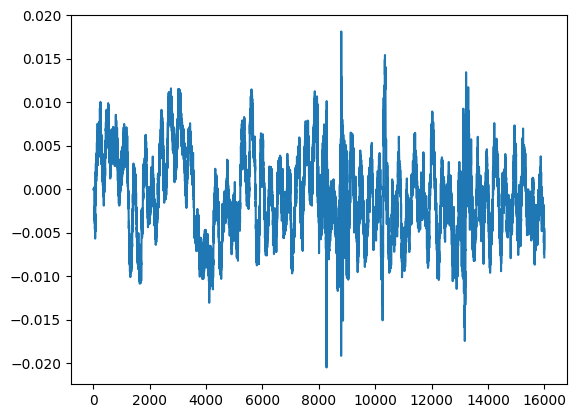

2024-06-17 20:39:09.772486: W tensorflow/core/kernels/data/cache_dataset_ops.cc:768] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


In [35]:
for wav, _, _ in split_background_noise_wav_ds.take(1):
  display.display(display.Audio(wav, rate=sample_rate))
  _ = plt.plot(wav)
  plt.show()

TensorFlow Lite for Microcontroller (TFLu) provides a subset of TensorFlow operations, so we are unable to use the `tf.signal.sft(...)` API we’ve used for feature extraction of the baseline model on our MCU. However, we can leverage Arm’s CMSIS-DSP library to generate spectrograms on the MCU. CMSIS-DSP contains support for both floating-point and fixed-point DSP operations which are optimized for Arm Cortex-M processors, including the Arm Cortex-M0+ that we will be deploying the ML model to. The Arm Cortex-M0+ does not contain a floating-point unit (FPU) so it would be better to leverage a 16-bit fixed-point DSP based feature extraction pipeline on the board.

We can leverage CMSIS-DSP’s Python Wrapper in the notebook to perform the same operations on our training pipeline using 16-bit fixed-point math. At a high level we can replicate the TensorFlow SFT API with the following CMSIS-DSP based operations:

 1. Manually creating a Hanning Window of length 256 using the Hanning Window formula along with CMSIS-DSP’s `arm_cos_f32` API.
 1. Creating a CMSIS-DSP `arm_rfft_instance_q15` instance and initializing it using CMSIS-DSP’s `arm_rfft_init_q15` API. 
 1. Looping through the audio data 256 samples at a time, with a stride of 128 (this matches the parameters we’ve passed into the TF sft API)
  1. Multiplying the 256 samples by the Hanning Window, using CMSIS-DSP’s `arm_mult_q15` API
  1. Calculating the FFT of the output of the previous step, using CMSIS-DSP’s `arm_rfft_q15` API
  1. Calculating the magnitude of the previous step, using CMSIS-DSP’s `arm_cmplx_mag_q15` API
 1. Each audio soundbites’s FFT magnitude represents the one column of the spectrogram.
 1. Since our baseline model expects a floating-point input, instead of the 16-bit quantized value we were using, the CMSIS-DSP `arm_q15_to_float` API can be used to convert the spectrogram data from a 16-bit fixed-point value to a floating-point value for training.

For an in-depth description of how to create audio spectrograms using fixed-point operations with CMSIS-DSP, please see the [Towards Data Science “Fixed-point DSP for Data Scientists” guide](https://towardsdatascience.com/fixed-point-dsp-for-data-scientists-d773a4271f7f).



In [36]:
import cmsisdsp
from numpy import pi as PI

window_size = 256
step_size = 128

hanning_window_f32 = np.zeros(window_size)
for i in range(window_size):
  hanning_window_f32[i] = 0.5 * (1 - cmsisdsp.arm_cos_f32(2 * PI * i / window_size ))

hanning_window_q15 = cmsisdsp.arm_float_to_q15(hanning_window_f32)

rfftq15 = cmsisdsp.arm_rfft_instance_q15()
status = cmsisdsp.arm_rfft_init_q15(rfftq15, window_size, 0, 1)

def get_arm_spectrogram(waveform):
  
  num_frames = int(1 + (len(waveform) - window_size) // step_size)
  fft_size = int(window_size // 2 + 1)

  # Convert the audio to q15
  waveform_q15 = cmsisdsp.arm_float_to_q15(waveform)

  # Create empty spectrogram array
  spectrogram_q15 = np.empty((num_frames, fft_size), dtype = np.int16)

  start_index = 0

  for index in range(num_frames):
    # Take the window from the waveform.
    window = waveform_q15[start_index:start_index + window_size]

    # Apply the Hanning Window.
    window = cmsisdsp.arm_mult_q15(window, hanning_window_q15)

    # Calculate the FFT, shift by 7 according to docs
    window = cmsisdsp.arm_rfft_q15(rfftq15, window)

    # Take the absolute value of the FFT and add to the Spectrogram.
    spectrogram_q15[index] = cmsisdsp.arm_cmplx_mag_q15(window)[:fft_size]

    # Increase the start index of the window by the overlap amount.
    start_index += step_size

  # Convert to numpy output ready for keras
  return cmsisdsp.arm_q15_to_float(spectrogram_q15).reshape(num_frames,fft_size) * 512

Let's create a spectrogram representation for all of the fire alarm soundbites, and plot the first spectrogram.

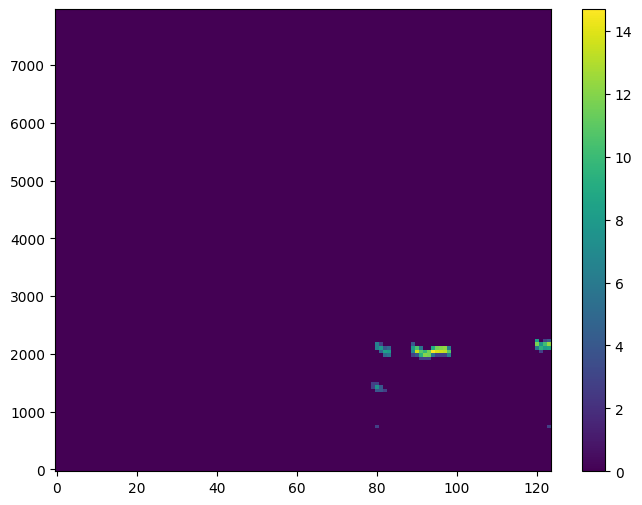

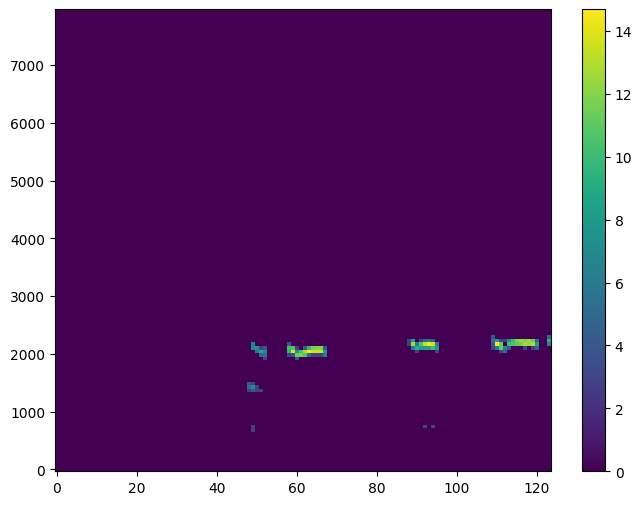

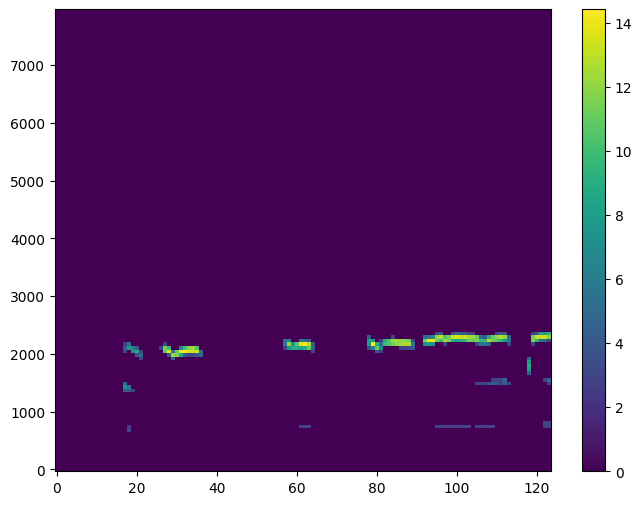

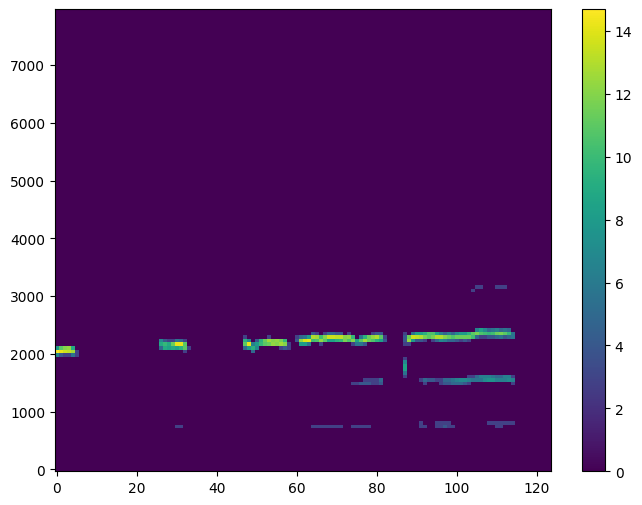

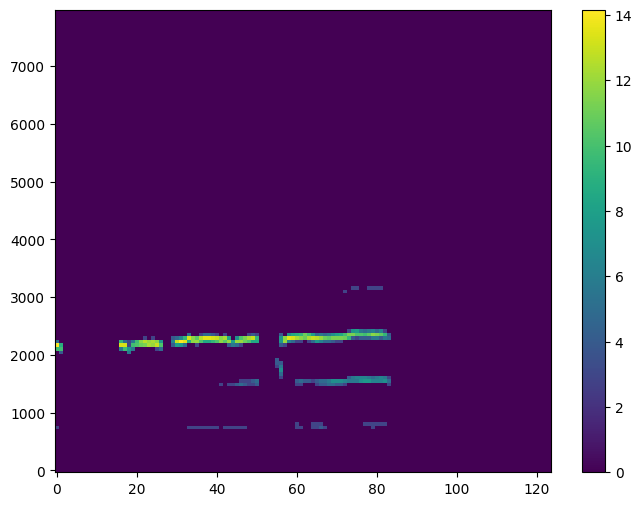

2024-06-17 20:39:10.809858: W tensorflow/core/kernels/data/cache_dataset_ops.cc:768] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.
2024-06-17 20:39:10.809924: W tensorflow/core/kernels/data/cache_dataset_ops.cc:768] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


In [37]:
@tf.function
def create_arm_spectrogram_for_map(wav, label, fold):
  spectrogram = tf.py_function(get_arm_spectrogram, [wav], tf.float32)

  return spectrogram, label, fold

meow_spectrograms_ds = split_meows_wav_ds.map(create_arm_spectrogram_for_map)
meow_spectrograms_ds = meow_spectrograms_ds.cache()

count = 0
try:
  for spectrogram, _, _ in meow_spectrograms_ds.take(5):
    count += 1
    plot_spectrogram(spectrogram)
except Exception as e:
  print(f"Exception: {e}")
  print(f"Count: {count}")


The do the same for the background noise soundbites:

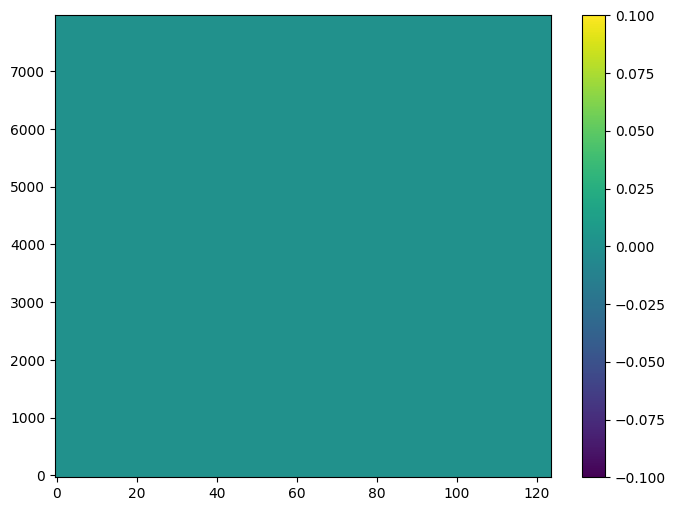

2024-06-17 20:39:13.426239: W tensorflow/core/kernels/data/cache_dataset_ops.cc:768] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.
2024-06-17 20:39:13.434038: W tensorflow/core/kernels/data/cache_dataset_ops.cc:768] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


In [38]:
background_noise_spectrograms_ds = split_background_noise_wav_ds.map(create_arm_spectrogram_for_map)
background_noise_spectrograms_ds = background_noise_spectrograms_ds.cache()

for spectrogram, _, _ in background_noise_spectrograms_ds.take(1):
  plot_spectrogram(spectrogram)

Now let's calculate the lengths of each dataset to see how balanced they are:

In [39]:
def calculate_ds_len(ds):
  count = 0
  for _, _, _ in ds:
    count += 1
  
  return count

num_meow_spectrograms = calculate_ds_len(meow_spectrograms_ds)
num_background_noise_spectrograms = calculate_ds_len(background_noise_spectrograms_ds)

print(f"num_meow_spectrograms = {num_meow_spectrograms}")
print(f"num_background_noise_spectrograms = {num_background_noise_spectrograms}")

num_meow_spectrograms = 974
num_background_noise_spectrograms = 6339


### Split Dataset

Now combine the spectrogram datasets, and split them into training, validation, and test sets. Instead of using the `fold` value to split them, we will shuffle all the items, and then split by percentage.

In [40]:
full_ds = tf.data.Dataset.concatenate(meow_spectrograms_ds, background_noise_spectrograms_ds)
full_ds = full_ds.cache()

full_ds_size = calculate_ds_len(full_ds)

print(f'full_ds_size = {full_ds_size}')

full_ds = full_ds.shuffle(full_ds_size)

full_ds_size = 7313


In [41]:
train_ds_size = int(0.60 * full_ds_size)
val_ds_size = int(0.20 * full_ds_size)
test_ds_size = int(0.20 * full_ds_size)

train_ds = full_ds.take(train_ds_size)

remaining_ds = full_ds.skip(train_ds_size) 
val_ds = remaining_ds.take(val_ds_size)
test_ds = remaining_ds.skip(val_ds_size)

# remove the folds column as it's no longer needed
remove_fold_column = lambda spectrogram, label, fold: (tf.expand_dims(spectrogram, axis=-1), label)

train_ds = train_ds.map(remove_fold_column)
val_ds = val_ds.map(remove_fold_column)
test_ds = test_ds.map(remove_fold_column)

train_ds = train_ds.cache().shuffle(1000).batch(32).prefetch(tf.data.AUTOTUNE)
val_ds = val_ds.cache().batch(32).prefetch(tf.data.AUTOTUNE)
test_ds = test_ds.cache().batch(32).prefetch(tf.data.AUTOTUNE)

### Replace Baseline Model Classification Head and Train Model

The model we previously trained on the ESC-50 dataset, predicted the presence of 50 sound types, and which resulted in the final dense layer of the model having 50 outputs. The new model we would like to create is a binary classifier, and needs to have a single output value.

We will load the baseline model, and swap out the final dense layer to match our needs:


In [42]:
# we need a new head with one neuron.
model_body = tf.keras.Model(inputs=baseline_model.input, outputs=baseline_model.layers[-2].output)

classifier_head = tf.keras.layers.Dense(1, activation="sigmoid")(model_body.output)

fine_tune_model = tf.keras.Model(model_body.input, classifier_head)

fine_tune_model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 124, 129, 1)]     0         
                                                                 
 resizing (Resizing)         (None, 32, 32, 1)         0         
                                                                 
 normalization (Normalizatio  (None, 32, 32, 1)        3         
 n)                                                              
                                                                 
 conv2d (Conv2D)             (None, 13, 13, 8)         520       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 6, 6, 8)          0         
 )                                                               
                                                                 
 flatten (Flatten)           (None, 288)               0   

To freeze a layer in TensorFlow we can set `layer.trainable = False`. Let's loop through all the layers and do this:

In [43]:
for layer in fine_tune_model.layers:
  layer.trainable = False

and now unfreeze the last layer (the head):

In [44]:
fine_tune_model.layers[-1].trainable = True

Then we can `compile` the model, this time with using a binary crossentropy loss function as this model contains a single output.

In [45]:
METRICS = [
      "accuracy",
]

fine_tune_model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.01),
    loss=tf.keras.losses.BinaryCrossentropy(from_logits=False),
    metrics=METRICS,
)

def scheduler(epoch, lr):
  if epoch < 10:
    return lr
  else:
    return lr * tf.math.exp(-0.1)

callbacks = [
    tf.keras.callbacks.EarlyStopping(verbose=1, patience=5), 
    tf.keras.callbacks.LearningRateScheduler(scheduler)
]

Kick off training:

In [46]:
EPOCHS = 25

history_1 = fine_tune_model.fit(
    train_ds, 
    validation_data=val_ds,  
    epochs=EPOCHS,
    callbacks=callbacks,
)

Epoch 1/25
138/138 [==============================] - 1s 4ms/step - loss: 0.2341 - accuracy: 0.9305 - val_loss: 0.1831 - val_accuracy: 0.9473 - lr: 0.0100
Epoch 2/25
138/138 [==============================] - 0s 3ms/step - loss: 0.1861 - accuracy: 0.9496 - val_loss: 0.1719 - val_accuracy: 0.9528 - lr: 0.0100
Epoch 3/25
138/138 [==============================] - 0s 3ms/step - loss: 0.1789 - accuracy: 0.9528 - val_loss: 0.1663 - val_accuracy: 0.9549 - lr: 0.0100
Epoch 4/25
138/138 [==============================] - 0s 3ms/step - loss: 0.1784 - accuracy: 0.9553 - val_loss: 0.1621 - val_accuracy: 0.9583 - lr: 0.0100
Epoch 5/25
138/138 [==============================] - 0s 3ms/step - loss: 0.1733 - accuracy: 0.9562 - val_loss: 0.1592 - val_accuracy: 0.9603 - lr: 0.0100
Epoch 6/25
138/138 [==============================] - 0s 3ms/step - loss: 0.1743 - accuracy: 0.9565 - val_loss: 0.1556 - val_accuracy: 0.9603 - lr: 0.0100
Epoch 7/25
138/138 [==============================] - 1s 4ms/step - lo

Now unfreeze all the layers, and train for a few more epochs:

In [47]:
for layer in fine_tune_model.layers:
  layer.trainable = True

fine_tune_model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
    loss=tf.keras.losses.BinaryCrossentropy(from_logits=False),
    metrics=METRICS,
)

def scheduler(epoch, lr):
  return lr * tf.math.exp(-0.1)

callbacks = [
    tf.keras.callbacks.EarlyStopping(verbose=1, patience=5), 
    tf.keras.callbacks.LearningRateScheduler(scheduler)
]

In [48]:
EPOCHS = 20

history_2 = fine_tune_model.fit(
    train_ds, 
    validation_data=val_ds,  
    epochs=EPOCHS,
    callbacks=callbacks,
)

Epoch 1/20
138/138 [==============================] - 1s 5ms/step - loss: 0.1638 - accuracy: 0.9608 - val_loss: 0.1442 - val_accuracy: 0.9644 - lr: 9.0484e-05
Epoch 2/20
138/138 [==============================] - 1s 5ms/step - loss: 0.1626 - accuracy: 0.9608 - val_loss: 0.1440 - val_accuracy: 0.9644 - lr: 8.1873e-05
Epoch 3/20
138/138 [==============================] - 1s 5ms/step - loss: 0.1605 - accuracy: 0.9608 - val_loss: 0.1438 - val_accuracy: 0.9644 - lr: 7.4082e-05
Epoch 4/20
138/138 [==============================] - 1s 5ms/step - loss: 0.1588 - accuracy: 0.9622 - val_loss: 0.1436 - val_accuracy: 0.9644 - lr: 6.7032e-05
Epoch 5/20
138/138 [==============================] - 1s 5ms/step - loss: 0.1603 - accuracy: 0.9610 - val_loss: 0.1435 - val_accuracy: 0.9644 - lr: 6.0653e-05
Epoch 6/20
138/138 [==============================] - 1s 6ms/step - loss: 0.1614 - accuracy: 0.9622 - val_loss: 0.1432 - val_accuracy: 0.9644 - lr: 5.4881e-05
Epoch 7/20
138/138 [==========================

In [49]:
fine_tune_model.save("fine_tuned_model")

INFO:tensorflow:Assets written to: fine_tuned_model/assets


## Model Optimization

To optimize the model to run on the Arm Cortex-M0+ processor, we will use a process called model quantization. Model quantization converts the model’s weights and biases from 32-bit floating-point values to 8-bit values. The [pico-tflmicro](https://github.com/raspberrypi/pico-tflmicro) library, which is a port of TFLu for the RP2040’s Pico SDK contains Arm’s CMSIS-NN library, which supports optimized kernel operations for quantized 8-bit weights on Arm Cortex-M processors.



### Quantization Aware Training

We can use [TensorFlow’s Quantization Aware Training (QAT)](https://www.tensorflow.org/model_optimization/guide/quantization/training) feature to easily convert the floating-point model to quantized.

In [50]:
final_model = tf.keras.models.load_model("fine_tuned_model")

In [51]:
import tensorflow_model_optimization as tfmot

def apply_qat_to_dense_and_cnn(layer):
  if isinstance(layer, (tf.keras.layers.Dense, tf.keras.layers.Conv2D)):
    return tfmot.quantization.keras.quantize_annotate_layer(layer)
  return layer

annotated_model = tf.keras.models.clone_model(
    fine_tune_model,
    clone_function=apply_qat_to_dense_and_cnn,
)

quant_aware_model = tfmot.quantization.keras.quantize_apply(annotated_model)
quant_aware_model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 124, 129, 1)]     0         
                                                                 
 resizing (Resizing)         (None, 32, 32, 1)         0         
                                                                 
 normalization (Normalizatio  (None, 32, 32, 1)        3         
 n)                                                              
                                                                 
 quant_conv2d (QuantizeWrapp  (None, 13, 13, 8)        539       
 erV2)                                                           
                                                                 
 max_pooling2d (MaxPooling2D  (None, 6, 6, 8)          0         
 )                                                               
                                                           

In [52]:
quant_aware_model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss=tf.keras.losses.BinaryCrossentropy(from_logits=False),
    metrics=METRICS,
)

EPOCHS=1
quant_aware_history = quant_aware_model.fit(
    train_ds, 
    validation_data=val_ds,  
    epochs=EPOCHS
)

138/138 [==============================] - 2s 12ms/step - loss: 0.1725 - accuracy: 0.9603 - val_loss: 0.1449 - val_accuracy: 0.9637


In [53]:
converter = tf.lite.TFLiteConverter.from_keras_model(quant_aware_model)
converter.optimizations = [tf.lite.Optimize.DEFAULT]

def representative_data_gen():
  for input_value, output_value in train_ds.unbatch().batch(1).take(100):
    # Model has only one input so each data point has one element.
    yield [input_value]
    
converter.representative_dataset = representative_data_gen
# Ensure that if any ops can't be quantized, the converter throws an error
converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS_INT8]
# Set the input and output tensors to uint8 (APIs added in r2.3)
converter.inference_input_type = tf.int8
converter.inference_output_type = tf.int8
tflite_model_quant = converter.convert()

with open("tflite_model.tflite", "wb") as f:
  f.write(tflite_model_quant)

INFO:tensorflow:Assets written to: /tmp/tmpcqp4v3st/assets


INFO:tensorflow:Assets written to: /tmp/tmpcqp4v3st/assets
/home/guay/.local/lib/python3.10/site-packages/tensorflow/lite/python/convert.py:746: UserWarning: Statistics for quantized inputs were expected, but not specified; continuing anyway.
  warnings.warn("Statistics for quantized inputs were expected, but not "
2024-06-17 20:40:21.977690: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:357] Ignored output_format.
2024-06-17 20:40:21.977731: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:360] Ignored drop_control_dependency.
2024-06-17 20:40:21.978712: I tensorflow/cc/saved_model/reader.cc:43] Reading SavedModel from: /tmp/tmpcqp4v3st
2024-06-17 20:40:21.981614: I tensorflow/cc/saved_model/reader.cc:78] Reading meta graph with tags { serve }
2024-06-17 20:40:21.981642: I tensorflow/cc/saved_model/reader.cc:119] Reading SavedModel debug info (if present) from: /tmp/tmpcqp4v3st
2024-06-17 20:40:21.993331: I tensorflow/cc/saved_model/loader.cc:2

### Test TF Lite model

Since TensorFlow also supports loading TF Lite models using [`tensorflow.lite`](https://www.tensorflow.org/api_docs/python/tf/lite), we can also verify the functionality of the quantized model and compare its accuracy with the regular unquantized model inside the notebook.

In [54]:
import tensorflow.lite as tflite

# Load the interpreter and allocate tensors
interpreter = tflite.Interpreter("tflite_model.tflite")
interpreter.allocate_tensors()

# Load input and output details
input_details = interpreter.get_input_details()[0]
output_details = interpreter.get_output_details()[0]

# Set quantization values
input_scale, input_zero_point = input_details["quantization"]
output_scale, output_zero_point = output_details["quantization"]

## Deploy on Device

#### Convert `.tflite` to `.h` file

The RP2040 MCU on the boards we are deploying to, does not have a built-in file system, which means we cannot use the .tflite file directly on the board. However, we can use the Linux `xxd` command to convert the .tflite file to a .h file which can then be compiled in the inference application in the next step.

In [55]:
!echo "alignas(8) const unsigned char tflite_model[] = {" > tflite_model.h
!cat tflite_model.tflite | xxd -i                        >> tflite_model.h
!echo "};"                                               >> tflite_model.h

In [56]:
# Calculate the number of correct predictions
correct = 0
test_ds_len = 0

# Loop through entire test set
for x, y in test_ds.unbatch():
  # original shape is [124, 129, 1] expand to [1, 124, 129, 1]
  x = tf.expand_dims(x, 0).numpy()
  
  # quantize the input value
  if (input_scale, input_zero_point) != (0, 0):
    x = x / input_scale + input_zero_point
  x = x.astype(input_details['dtype'])

  # add the input tensor to interpreter
  interpreter.set_tensor(input_details["index"], x)
  
  #run the model
  interpreter.invoke()

  # Get output data from model and convert to fp32
  output_data = interpreter.get_tensor(output_details["index"])
  output_data = output_data.astype(np.float32)

  # Dequantize the output
  if (output_scale, output_zero_point) != (0.0, 0):
    output_data = (output_data - output_zero_point) * output_scale

  # convert output to category
  if output_data[0][0] >= 0.5:
    category = 1
  else:
    category = 0
  
  # add 1 if category = y
  correct += 1 if category == y.numpy() else 0

  test_ds_len += 1

In [57]:
accuracy = correct / test_ds_len
print(f"Accuracy for quantized model is {accuracy*100:.2f}% (to 2 D.P) on test set.")

Accuracy for quantized model is 96.45% (to 2 D.P) on test set.


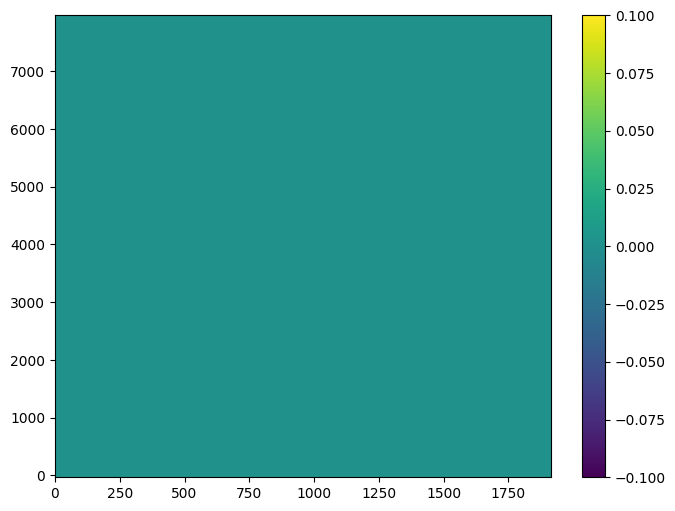

(1, 124, 129, 1)
Prediction for meow sound: 0.05078125


In [58]:
#Test the model with a meow sound
meow_file_path = "ruido.wav"
meow_data = load_wav(meow_file_path, sample_rate, channels)
meow_spectrogram = tf.py_function(get_arm_spectrogram, [meow_data], tf.float32)

plot_spectrogram(meow_spectrogram)

# Load the interpreter and allocate tensors
interpreter = tflite.Interpreter("tflite_model.tflite")
interpreter.allocate_tensors()

# Load input and output details
input_details = interpreter.get_input_details()[0]
output_details = interpreter.get_output_details()[0]

# Set quantization values
input_scale, input_zero_point = input_details["quantization"]
output_scale, output_zero_point = output_details["quantization"]

# original shape is [142, 129] expand to [1, 124, 129, 1]

meow_spectrogram = meow_spectrogram[:124, :]

meow_spectrogram = tf.expand_dims(meow_spectrogram, 0).numpy()

meow_spectrogram = tf.expand_dims(meow_spectrogram, 3).numpy()

print(meow_spectrogram.shape)

# quantize the input value
if (input_scale, input_zero_point) != (0, 0):
  meow_spectrogram = meow_spectrogram / input_scale + input_zero_point

meow_spectrogram = meow_spectrogram.astype(input_details['dtype'])

# add the input tensor to interpreter
interpreter.set_tensor(input_details["index"], meow_spectrogram)

#run the model
interpreter.invoke()

# Get output data from model and convert to fp32

output_data = interpreter.get_tensor(output_details["index"])
output_data = output_data.astype(np.float32)

# Dequantize the output
if (output_scale, output_zero_point) != (0.0, 0):
  output_data = (output_data - output_zero_point) * output_scale

# convert output to category

if output_data[0][0] >= 0.5:
  category = 1
else:
  category = 0

print(f"Prediction for meow sound: {output_data[0][0]}")